In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import scipy.ndimage as filters
from materials import pm

In [2]:
PATH = 'materials/'

In [3]:
fountain1 = cv2.imread(f'{PATH}/fontanna1.jpg')
fountain2 = cv2.imread(f'{PATH}fontanna2.jpg')

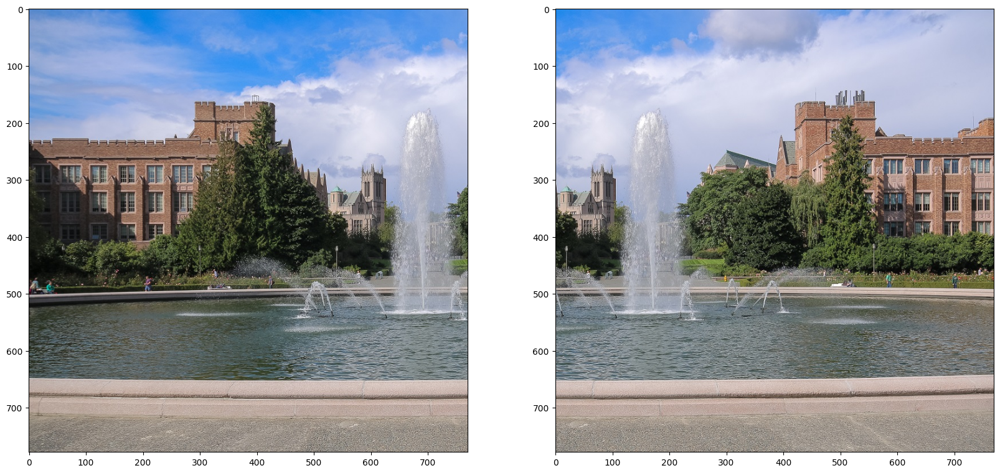

In [4]:
fig, ax = plt.subplots(1, 2, figsize=(20, 20))
ax[0].imshow(cv2.cvtColor(fountain1, cv2.COLOR_BGR2RGB))
ax[1].imshow(cv2.cvtColor(fountain2, cv2.COLOR_BGR2RGB))

### Metoda Harrisa

In [5]:
def harris(image):

    def compute_H(image, kernel_size=7, k=0.05):
        sobel_x = cv2.Sobel(image, cv2.CV_32F, 1, 0, ksize=kernel_size)
        sobel_y = cv2.Sobel(image, cv2.CV_32F, 0, 1, ksize=kernel_size)

        sobel_xx = sobel_x * sobel_x
        sobel_yy = sobel_y * sobel_y
        sobel_xy = sobel_x * sobel_y

        sobel_xx_gauss = cv2.GaussianBlur(sobel_xx, (kernel_size, kernel_size), 0)
        sobel_yy_gauss = cv2.GaussianBlur(sobel_yy, (kernel_size, kernel_size), 0)
        sobel_xy_gauss = cv2.GaussianBlur(sobel_xy, (kernel_size, kernel_size), 0)

        det = sobel_xx_gauss * sobel_yy_gauss - sobel_xy_gauss ** 2
        trace = sobel_xx_gauss + sobel_yy_gauss

        harris = det - k * trace ** 2
        harris = cv2.normalize(harris, None, 0, 1, cv2.NORM_MINMAX, dtype=cv2.CV_32F)

        return harris


    def find_max(image, size=7, threshold=0.5):
        data_max = filters.maximum_filter(image, size)
        maxima = (image == data_max)
        diff = image > threshold
        maxima[diff == 0] = 0
        return np.nonzero(maxima)

    def draw_maxima(image, x, y):
        plt.figure(figsize=(10, 10))
        plt.imshow(image, cmap='gray')
        plt.axis('off')
        plt.plot(x, y, '*', color='r')  # 'x' for red crosses
        plt.show()

    img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    h = compute_H(img)
    y, x = find_max(h)
    img = draw_maxima(img, x, y)

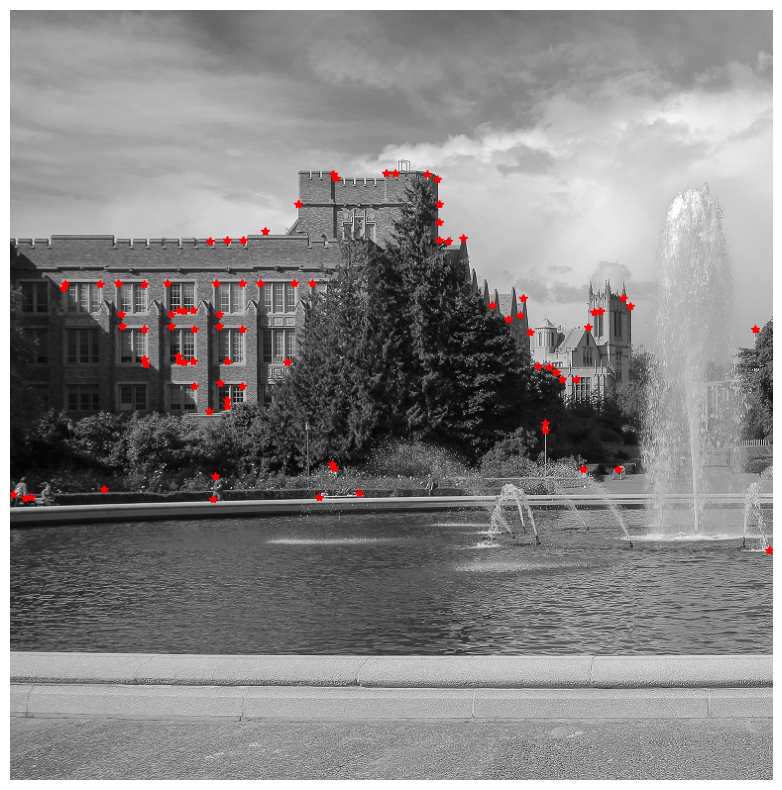

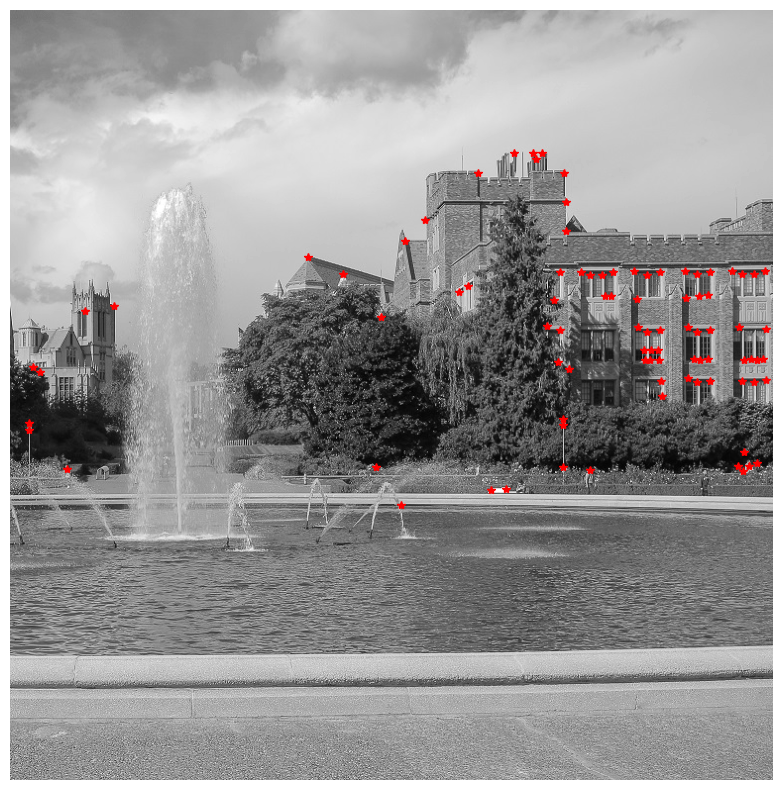

In [6]:
harris(fountain1)
harris(fountain2)

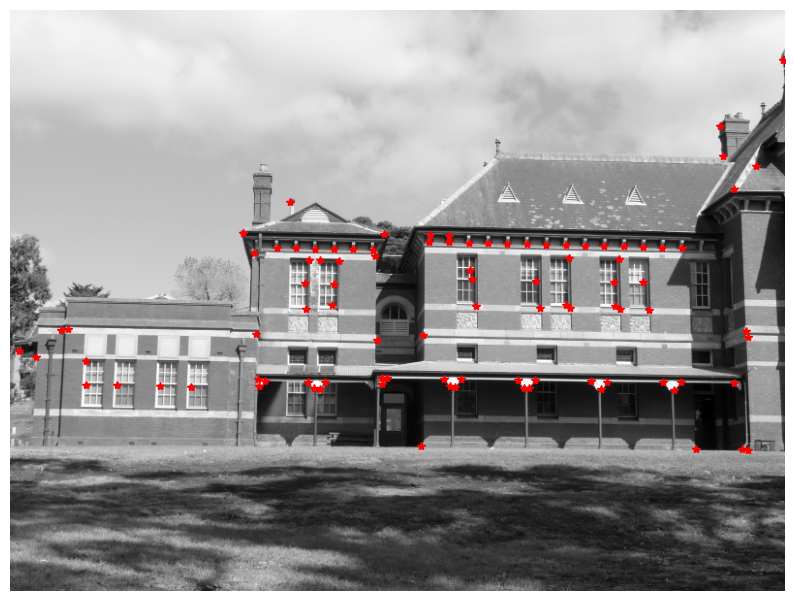

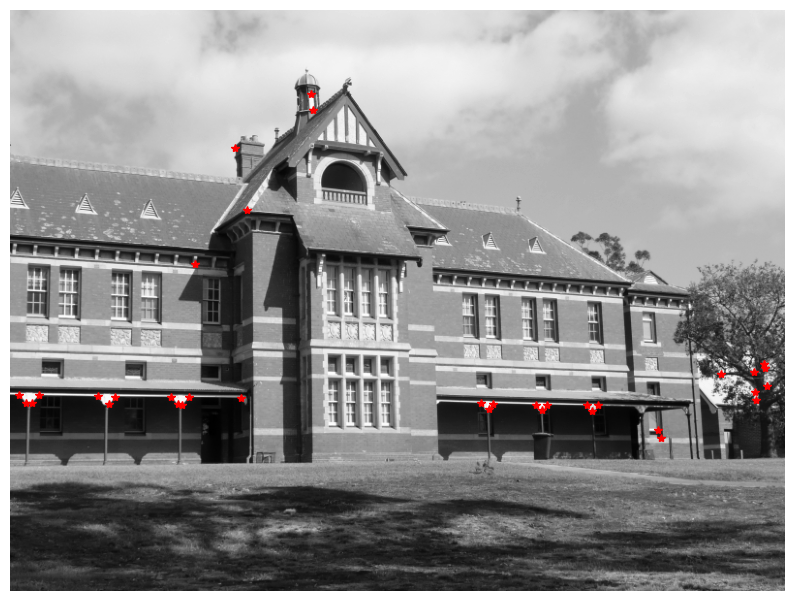

In [7]:
building_1 = cv2.imread(f'{PATH}budynek1.jpg')
building_2 = cv2.imread(f'{PATH}budynek2.jpg')
harris(building_1)
harris(building_2)

### Prosta deskrypcja punktów charakterystycznych

In [ ]:
def characteristic_point_description(image1, image2, size=7, threshold=0.5, n=20):

    def compute_H(image, kernel_size=size, k=0.05):
        sobel_x = cv2.Sobel(image, cv2.CV_32F, 1, 0, ksize=kernel_size)
        sobel_y = cv2.Sobel(image, cv2.CV_32F, 0, 1, ksize=kernel_size)

        sobel_xx = sobel_x * sobel_x
        sobel_yy = sobel_y * sobel_y
        sobel_xy = sobel_x * sobel_y

        sobel_xx_gauss = cv2.GaussianBlur(sobel_xx, (kernel_size, kernel_size), 0)
        sobel_yy_gauss = cv2.GaussianBlur(sobel_yy, (kernel_size, kernel_size), 0)
        sobel_xy_gauss = cv2.GaussianBlur(sobel_xy, (kernel_size, kernel_size), 0)

        det = sobel_xx_gauss * sobel_yy_gauss - sobel_xy_gauss ** 2
        trace = sobel_xx_gauss + sobel_yy_gauss

        harris = det - k * trace ** 2
        harris = cv2.normalize(harris, None, 0, 1, cv2.NORM_MINMAX, dtype=cv2.CV_32F)

        return harris

    def find_max(image, size=size, threshold=threshold):
        data_max = filters.maximum_filter(image, size)
        maxima = (image == data_max)
        diff = image > threshold
        maxima[diff == 0] = 0
        return np.nonzero(maxima)
    
    def create_descriptors(image, pts, size=15):
        Y, X = image.shape[:2]
        pts = list(filter(lambda pt: pt[0] >= size and pt[0]< Y-size and pt[1] >= size and pt[1] < X-size, zip(pts[0], pts[1])))
        descriptors = []
        for keypoint in pts:
            y, x = keypoint
            patch = image[y - size:y + size + 1, x - size:x + size + 1]
            mean_patch = np.mean(patch)
            std_patch = np.std(patch)
            patch = (patch - mean_patch) / std_patch
            descriptors.append(patch.flatten())
        return descriptors, pts
    
    def get_descriptors_with_cords(img):
        h = compute_H(img)
        pts = find_max(h)
        descriptors, pts = create_descriptors(img, pts)
        return list(zip(descriptors, pts))
    
    def compare_descriptors(desc1, desc2):
        closest = []
        for d1, p1 in desc1:
            min_dist = float('inf')
            closest_point = None
            for d2, p2 in desc2:
                dist = np.sum(np.abs(d1 - d2))
                if dist < min_dist:
                    min_dist = dist
                    closest_point = p2
            closest.append((p1, closest_point, min_dist))
        closest.sort(key=lambda x: x[2])
        return closest[:n]
    
    image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)
    descriptors1 = get_descriptors_with_cords(image1)
    descriptors2 = get_descriptors_with_cords(image2)
    best_descriptors = compare_descriptors(descriptors1, descriptors2)
    best_descriptors = [(x, y) for x, y, _ in best_descriptors]
    pm.plot_matches(image1, image2, best_descriptors)

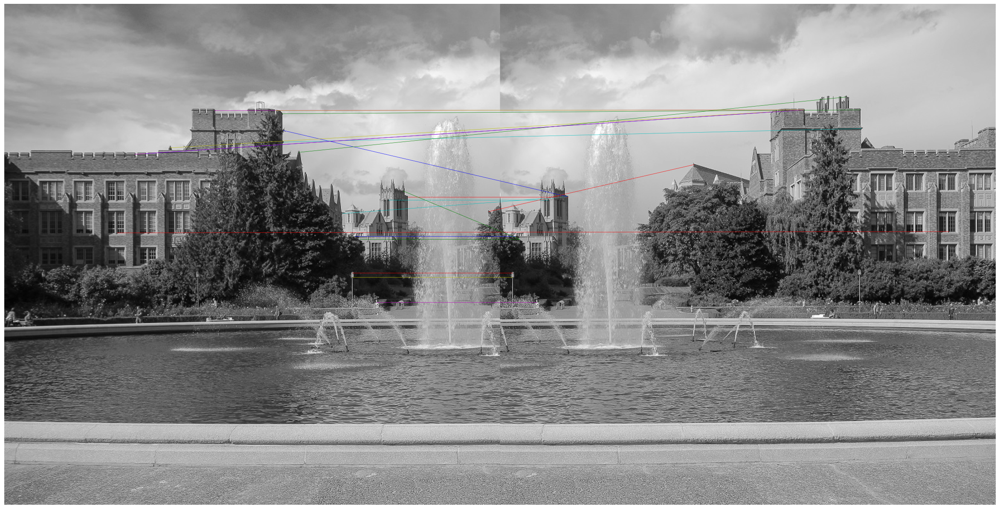

In [9]:
characteristic_point_description(fountain1, fountain2)

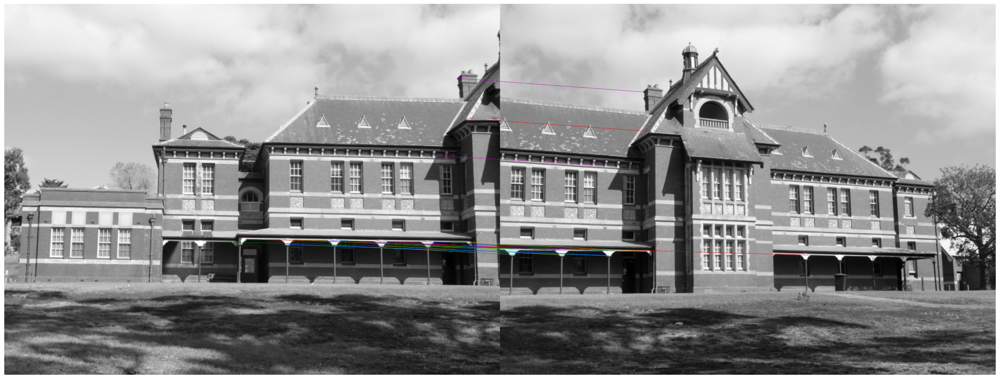

In [10]:
characteristic_point_description(building_1, building_2)

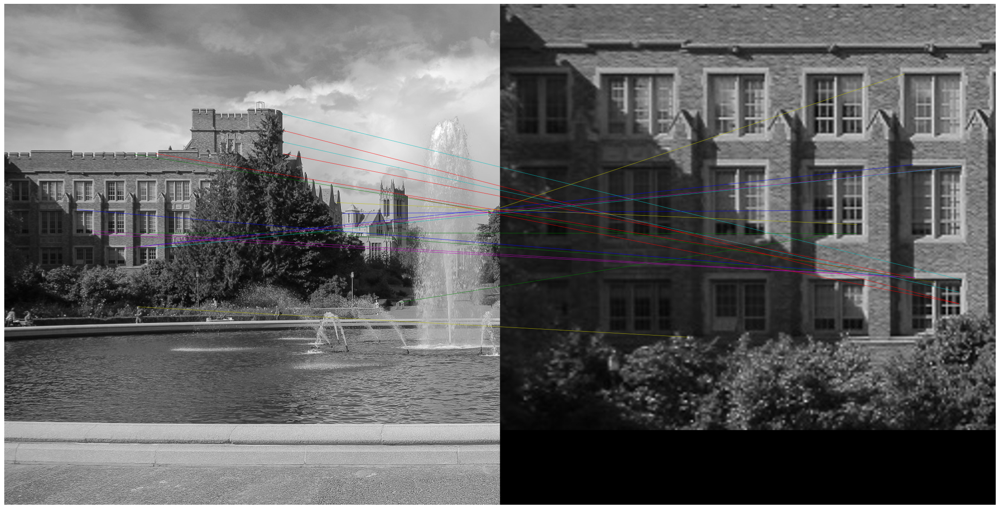

In [11]:
fountain_pow = cv2.imread(f'{PATH}fontanna_pow.jpg')
characteristic_point_description(fountain1, fountain_pow)

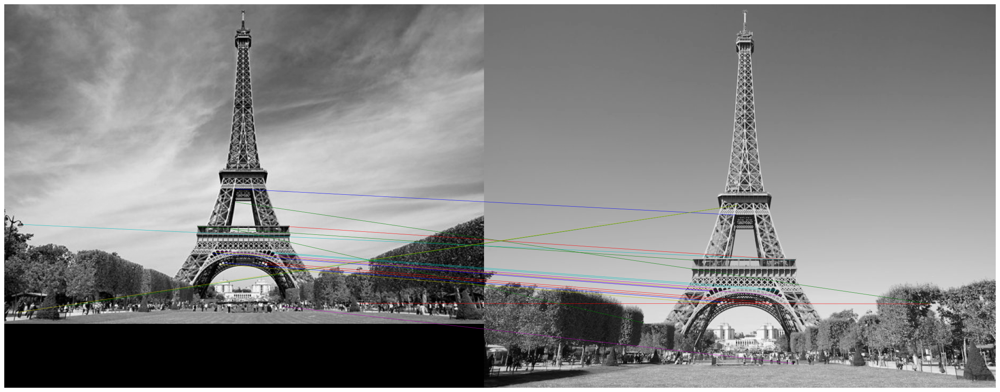

In [12]:
eiffel1 = cv2.imread(f'{PATH}eiffel1.jpg')
eiffel2 = cv2.imread(f'{PATH}eiffel2.jpg')
characteristic_point_description(eiffel1, eiffel2)

### 6.3 ORB

In [13]:
def bresenham_circle(radius):
    points = []
    x = 0
    y = radius
    d = 3 - 2 * radius

    while y >= x:
        points.extend([(x, y), (y, x), (y, -x), (x, -y), (-x, -y), (-y, -x), (-y, x), (-x, y)])
        x += 1

        if d > 0:
            y -= 1
            d = d + 4 * (x - y) + 10
        else:
            d = d + 4 * x + 6

    return list(set(points)) 

def bresenham_circle_full(radius):
    points = []
    for x in range(-radius, radius+1):
        for y in range(-radius, radius+1):
            if x**2 + y**2 <= radius**2:
                points.append((x, y))
    return points


In [ ]:
def _fast_detector(patch, t=10):
    n = patch.shape[0]//2
    Ic = patch[n, n]
    r_points = [(3,0), (3,1), (2,2), (1, 3), (0, 3), (-1, 3), (-2, 2), (-3, 1), (-3, 0), (-3, -1), (-2, -2), (-1, -3), (0, -3), (1, -3), (2, -2), (3, -1)]
    np.concatenate((r_points, r_points[:9]))
    n_straight_lower = True
    nl = 0
    n_straight_higher = True
    nh = 0
    for y, x in r_points:
        if Ic - t < patch[n+y, n+x] and nl<9:
            n_straight_lower = False
            nl = 0
        if Ic + t > patch[n+y, n+x] and nh<9:
            n_straight_higher = False
            nh = 0

        if nl == 9 or nh == 9:
            return True

        nl = nl + 1
        nh = nh + 1

    return n_straight_lower or n_straight_higher



def compute_H(image, kernel_size=7, k=0.05):
    sobel_x = cv2.Sobel(image, cv2.CV_32F, 1, 0, ksize=kernel_size)
    sobel_y = cv2.Sobel(image, cv2.CV_32F, 0, 1, ksize=kernel_size)

    sobel_xx = sobel_x * sobel_x
    sobel_yy = sobel_y * sobel_y
    sobel_xy = sobel_x * sobel_y

    sobel_xx_gauss = cv2.GaussianBlur(sobel_xx, (kernel_size, kernel_size), 0)
    sobel_yy_gauss = cv2.GaussianBlur(sobel_yy, (kernel_size, kernel_size), 0)
    sobel_xy_gauss = cv2.GaussianBlur(sobel_xy, (kernel_size, kernel_size), 0)

    det = sobel_xx_gauss * sobel_yy_gauss - sobel_xy_gauss ** 2
    trace = sobel_xx_gauss + sobel_yy_gauss

    harris = det - k * trace ** 2
    harris = cv2.normalize(harris, None, 0, 1, cv2.NORM_MINMAX, dtype=cv2.CV_32F)

    return harris


def non_maxima_suppression(image, points):
    best_points = []
    for y, x in points:
        max_point = image[y, x]
        patch = image[y-3:y+4, x-3:x+4]
        if np.count_nonzero(patch) < 5:
            best_points.append((y, x))
        elif max_point == np.max(patch):
            best_points.append((y, x))

    return best_points


def delete_redundant(points, Y, X):
    new_points = []
    for y, x in points:
        if 15 < y < Y-15 and 15 < x < X-15:
            new_points.append((y, x))
    return new_points


def intensity_centroid(image, points):
    r_points = bresenham_circle_full(15)
    C = []
    theta = []
    for y, x, _ in points:
        m00 = 0
        m10 = 0
        m01 = 0
        for j, i in r_points:
            m10 += x * image[y+j, x+i]
            m01 += y * image[y+j, x+i]
            m00 += image[y+j, x+i]
        C.append((m10//m00, m01//m00))
        theta.append(np.arctan2(m01, m10))
    return C, theta


def rotate_pair(pair, alfa):
    x1, y1 = pair[0]
    x2, y2 = pair[1]
    x1_new = x1 * np.cos(alfa) - y1 * np.sin(alfa)
    y1_new = y1 * np.sin(alfa) + x1 * np.cos(alfa)
    x2_new = x2 * np.cos(alfa) - y2 * np.sin(alfa)
    y2_new = y2 * np.sin(alfa) + x2 * np.cos(alfa)
    pair[0] = (x1_new, y1_new)
    pair[1] = (x2_new, y2_new)
    return pair


def brief_descriptor(image, points, theta, pair_positions, size=15):
    image1 = image.copy()
    descriptor = []

    for (x, y), alfa in zip(points, theta):
        patch = image1[y-size:y+size+1, x-size:x+size+1]
        patch = cv2.GaussianBlur(patch, (5, 5), 0)
        descriptor_vector = []
        for pair in pair_positions:
            x1, y1 = pair[0]
            x2, y2 = pair[1]
            if patch[y1, x1] < patch[y2, x2]:
                descriptor_vector.append(1)
            else:
                descriptor_vector.append(0)
        descriptor.append(descriptor_vector)
    
    return descriptor


def fast_detector(image, pair_positions, t=0.1, n=50):
    Y, X = image.shape[:2]
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    harris_fast = np.zeros(image.shape)
    keypoints = []
    for y in range(3, Y-3):
        for x in range(3, X-3):
            patch = image[y-3:y+4, x-3:x+4]
            if _fast_detector(patch, t):
                keypoints.append((y, x))
    
    harris = compute_H(image)

    for y, x in keypoints:
        harris_fast[y, x] = harris[y, x]
    
    keypoints = non_maxima_suppression(harris_fast, keypoints)
    keypoints = delete_redundant(keypoints, Y, X)
    keypoints_with_harris = [(y, x, harris[y, x]) for y, x in keypoints]
    keypoints_with_harris.sort(key=lambda x: x[2], reverse=True)
    keypoints_with_harris = keypoints_with_harris[:n]

    C, theta = intensity_centroid(image, keypoints_with_harris)
    descriptor = brief_descriptor(image, C, theta, pair_positions)
    
    return C, descriptor, keypoints_with_harris, theta

In [22]:
points = open(f'{PATH}orb_descriptor_positions.txt', 'r').read().split()
points = np.float32(points).reshape(256, 2, 2)
points.shape

(256, 2, 2)

In [23]:
pair_positions = np.random.randint(-9, 10, size=(256, 2, 2))
c1, d1, kh1, th1 = fast_detector(fountain1, pair_positions)
c2, d2, kh2, th2 = fast_detector(fountain2, pair_positions)

In [24]:
def draw_maxima(image, c):
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    plt.figure(figsize=(10, 10))
    plt.imshow(image, cmap='gray')
    plt.axis('off')
    for x, y in c:
        plt.plot(x, y, '*', color='r')
    plt.show()

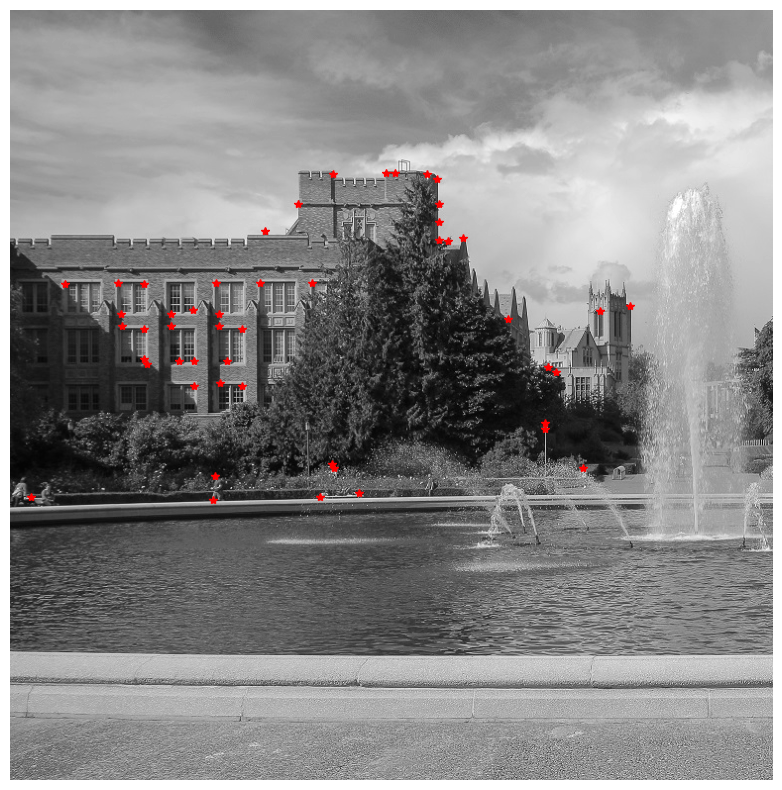

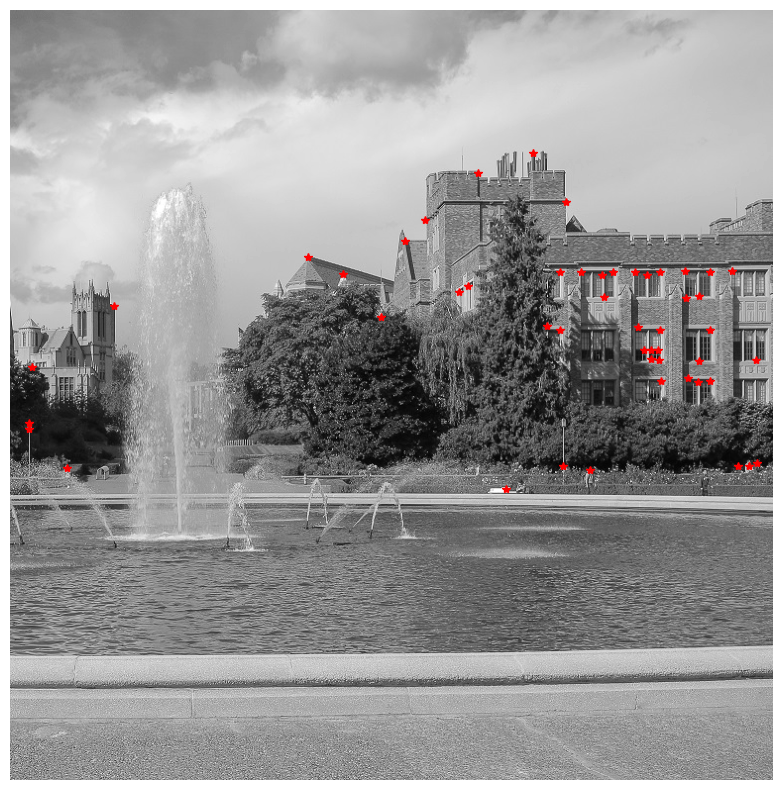

In [25]:
draw_maxima(fountain1, c1)
draw_maxima(fountain2, c2)

In [30]:
def compare_points(desc1, desc2, center1, center2, image1, image2):
    image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)
    distances = []

    for d1, c1 in zip(desc1, center1):
        lowest_dist = float('inf')
        for d2, c2 in zip(desc2, center2):
            new_dist = sum(char1 != char2 for char1, char2 in zip(d1, d2))
            if new_dist < lowest_dist:
                lowest_dist = new_dist
                best_match = c2
        distances.append(((c1[1], c1[0]), (best_match[1], best_match[0]), lowest_dist))

    distances.sort(key=lambda x: x[2])
    best_matches = [(x, y) for x, y, _ in distances[:100]]
    pm.plot_matches(image1, image2, best_matches)

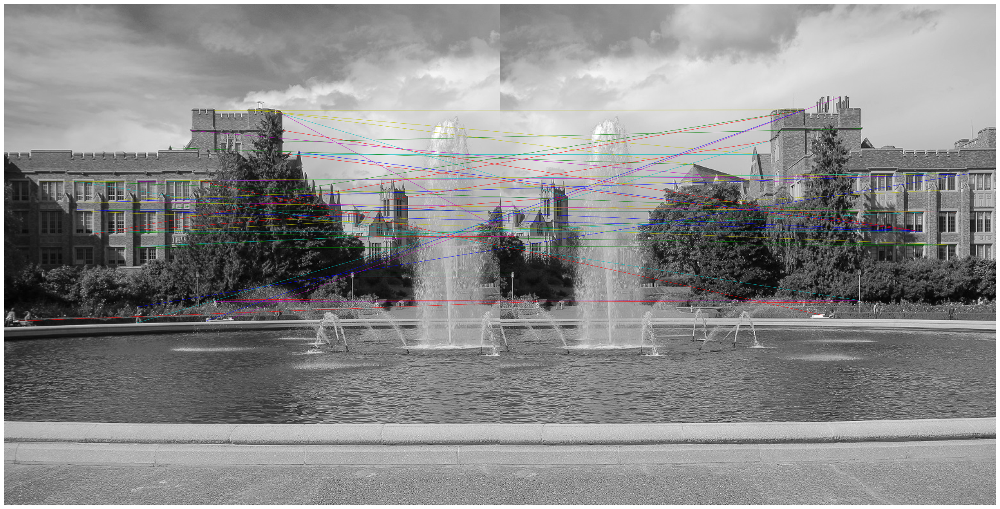

In [31]:
compare_points(d1, d2, c1, c2, fountain1, fountain2)

In [35]:
def orb_compare(image1, image2):
    c1, d1, _, _ = fast_detector(image1, pair_positions)
    c2, d2, _, _ = fast_detector(image2, pair_positions)
    draw_maxima(image1, c1)
    draw_maxima(image2, c2)
    compare_points(d1, d2, c1, c2, image1, image2)

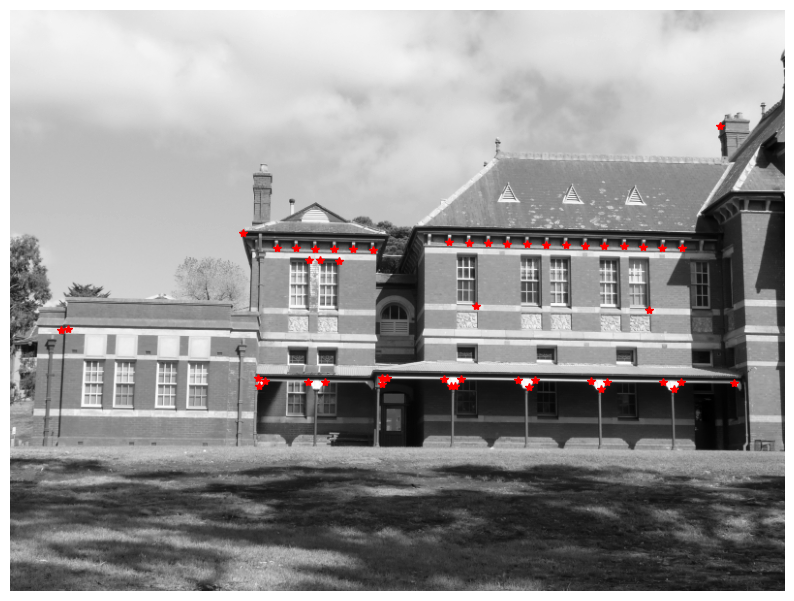

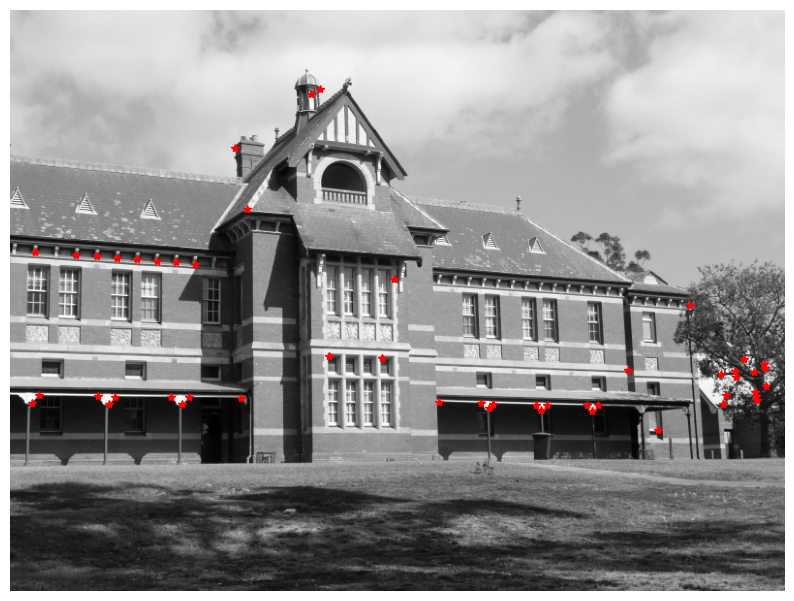

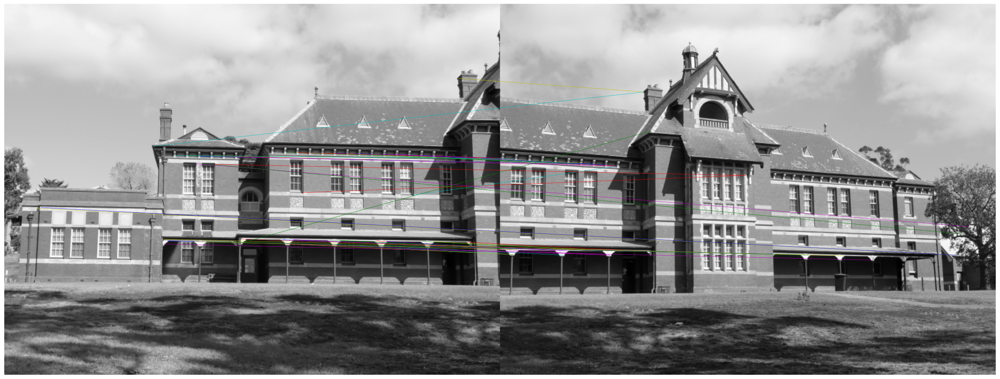

In [36]:
orb_compare(building_1, building_2)

### Wykorzystanie punktów charakterystycznych do łączenia obrazów

In [47]:
left = cv2.imread(f'{PATH}left_panorama.jpg', cv2.IMREAD_GRAYSCALE)
right = cv2.imread(f'{PATH}right_panorama.jpg', cv2.IMREAD_GRAYSCALE)

In [48]:
orb_descriptor = cv2.ORB_create()
kp_left, des_left = orb_descriptor.detectAndCompute(left, None)
kp_right, des_right = orb_descriptor.detectAndCompute(right, None)

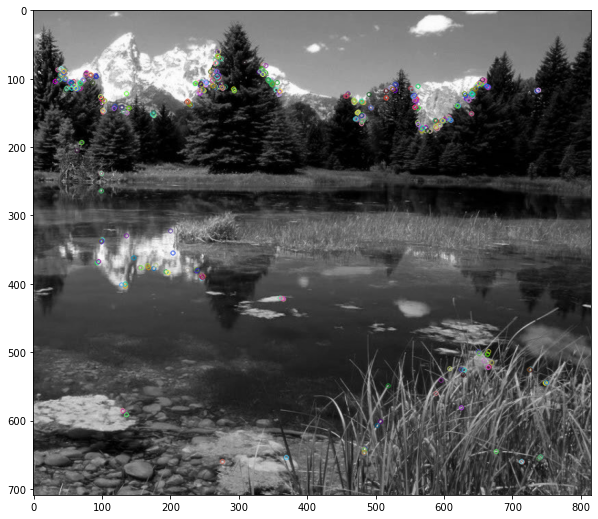

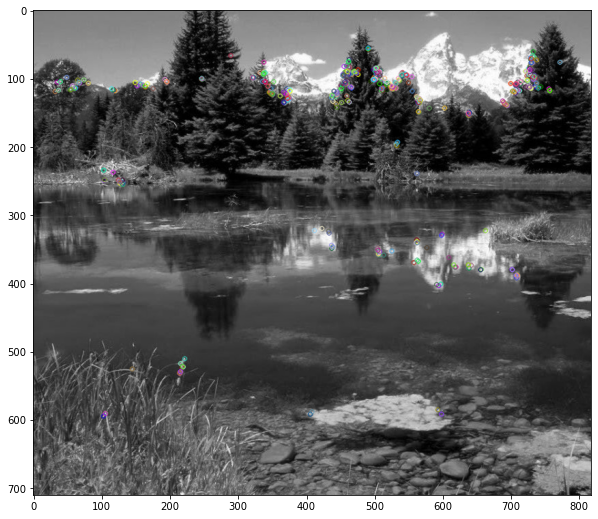

In [49]:
im_l = cv2.drawKeypoints(left, kp_left, None)
im_r = cv2.drawKeypoints(right, kp_right, None)
plt.figure(figsize=(10, 10))
plt.imshow(im_l)
plt.show()
plt.figure(figsize=(10, 10))
plt.imshow(im_r)

In [50]:
matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = matcher.match(des_left, des_right)
best_matches = sorted(matches, key=lambda x: x.distance)[:20]

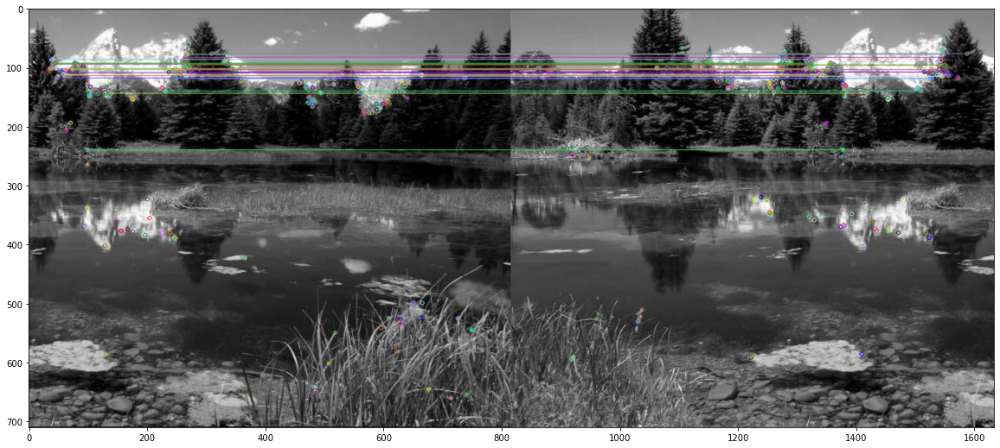

In [51]:
result_matches = cv2.drawMatches(left, kp_left, right, kp_right, best_matches, None)
plt.figure(figsize=(20, 20))
plt.imshow(result_matches)

In [52]:
kp_left = np.float32([kp.pt for kp in kp_left])
kp_right = np.float32([kp.pt for kp in kp_right])
ptsA = np.float32([kp_left[m.queryIdx] for m in best_matches])
ptsB = np.float32([kp_right[m.trainIdx] for m in best_matches])

H, _ = cv2.findHomography(ptsA, ptsB)

width = left.shape[1] + right.shape[1]
height = max(left.shape[0], right.shape[0])

result = cv2.warpPerspective(left, H, (width, height))
result[0:right.shape[0], 0:right.shape[1]] = right

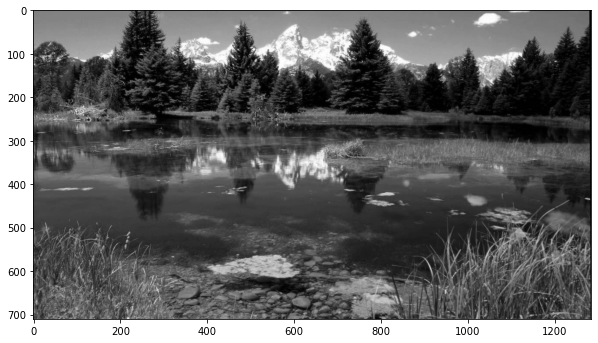

In [54]:
_, thresh = cv2.threshold(result, 1, 255, cv2.THRESH_BINARY)
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
x, y, w, h = cv2.boundingRect(contours[0])
result1 = result[y:y+h, x:x+w]

plt.figure(figsize=(10,10))
plt.imshow(result1, cmap='gray')

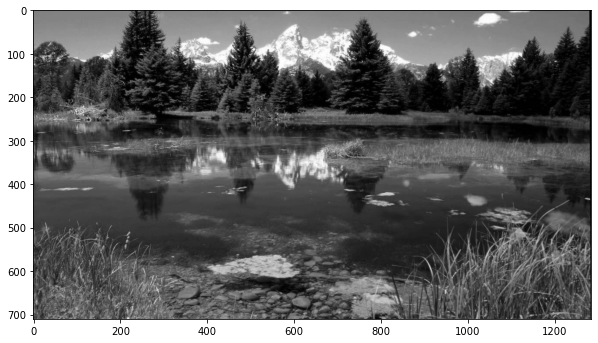

In [55]:
def merge_images(img1, img2):
    orb_descriptor = cv2.ORB_create()
    kp_left, des_left = orb_descriptor.detectAndCompute(img1, None)
    kp_right, des_right = orb_descriptor.detectAndCompute(img2, None)

    matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = matcher.match(des_left, des_right)
    best_matches = sorted(matches, key=lambda x: x.distance)[:20]

    kp_left = np.float32([kp.pt for kp in kp_left])
    kp_right = np.float32([kp.pt for kp in kp_right])
    ptsA = np.float32([kp_left[m.queryIdx] for m in best_matches])
    ptsB = np.float32([kp_right[m.trainIdx] for m in best_matches])

    H, _ = cv2.findHomography(ptsA, ptsB)

    width = left.shape[1] + right.shape[1]
    height = max(left.shape[0], right.shape[0])

    result = cv2.warpPerspective(left, H, (width, height))
    result[0:right.shape[0], 0:right.shape[1]] = right

    _, thresh = cv2.threshold(result, 1, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    x, y, w, h = cv2.boundingRect(contours[0])
    return result[y:y+h, x:x+w]

result = merge_images(left, right)
plt.figure(figsize=(10,10))
plt.imshow(result, cmap='gray')

### SIFT

In [56]:
class Sift:
    def __init__(self):
        self.best_matches = None
        self.kp1 = None
        self.kp2 = None
    def compute(self, img1, img2, coef=0.5):
        sift = cv2.xfeatures2d.SIFT_create()
        self.kp1, des1 = sift.detectAndCompute(img1, None)
        self.kp2, des2 = sift.detectAndCompute(img2, None)
        bf = cv2.BFMatcher()
        matches = bf.knnMatch(des1, des2, k=2)
        self.best_matches = [ [m] for m,n in matches if m.distance < coef*n.distance]
    
    def plot(self, img1, img2):
        result = cv2.drawMatchesKnn(img1, self.kp1, img2,self.kp2, self.best_matches, None, flags=2)
        plt.figure(figsize=(20, 20))
        plt.imshow(result)

[ WARN:0@22835.661] global shadow_sift.hpp:15 SIFT_create DEPRECATED: cv.xfeatures2d.SIFT_create() is deprecated due SIFT tranfer to the main repository. https://github.com/opencv/opencv/issues/16736


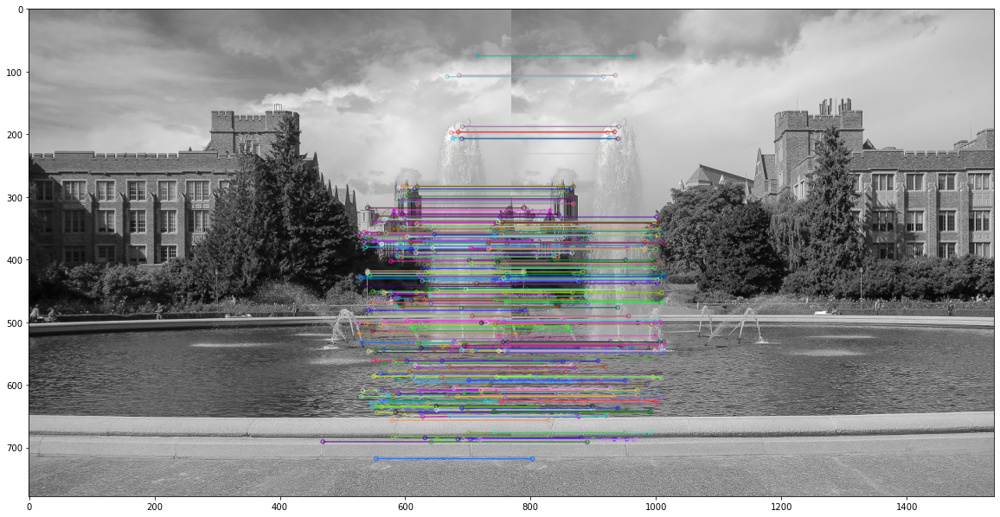

In [57]:
sift = Sift()
fountain1_g = cv2.imread(f'{PATH}fontanna1.jpg', cv2.IMREAD_GRAYSCALE)
fountain2_g = cv2.imread(f'{PATH}fontanna2.jpg', cv2.IMREAD_GRAYSCALE)
sift.compute(fountain1_g, fountain2_g)
sift.plot(fountain1_g, fountain2_g)

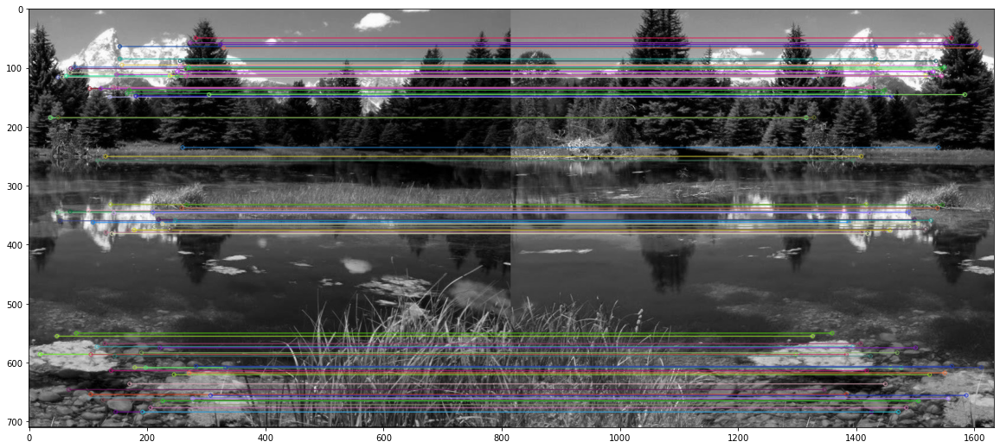

In [58]:
left = cv2.imread(f'{PATH}left_panorama.jpg', cv2.IMREAD_GRAYSCALE)
right = cv2.imread(f'{PATH}right_panorama.jpg', cv2.IMREAD_GRAYSCALE)
sift.compute(left, right, 0.03)
sift.plot(left, right)

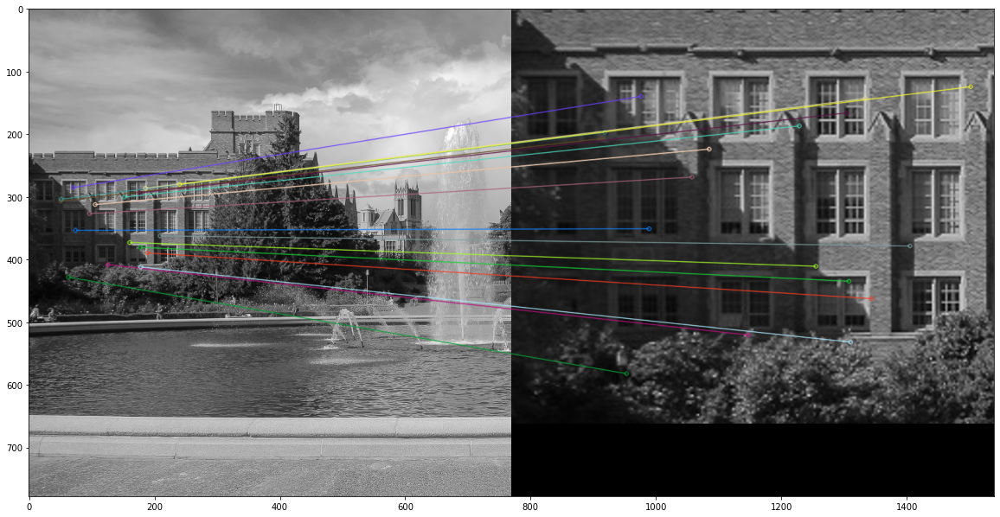

In [59]:
i1 = cv2.imread(f'{PATH}fontanna1.jpg', cv2.IMREAD_GRAYSCALE)
i2 = cv2.imread(f'{PATH}fontanna_pow.jpg', cv2.IMREAD_GRAYSCALE)
sift.compute(i1, i2, 0.1)
sift.plot(i1, i2)